In [3]:
import numpy as np
import unet_model1
import libs.patch_generator

Using TensorFlow backend.


In [4]:
%matplotlib inline
from matplotlib import pyplot as plt

In [ ]:
CLASSES = {
        1 : 'Bldg',
        2 : 'Struct',
        3 : 'Road',
        4 : 'Track',
        5 : 'Trees',
        6 : 'Crops',
        7 : 'Fast H20',
        8 : 'Slow H20',
        9 : 'Truck',
        10 : 'Car',
        }

In [8]:
# hype params to consider later
patch_size = 160
# chan = 1 # buildings
chan = 5 # trees

x = np.load("./prep/3band_in.npy")
y = np.load("./prep/3band_chan%d.npy" % chan)

gen = libs.patch_generator.DataGenerator(x,y,
    patchs_per_transform = 100,
    patch_size           = patch_size)

In [9]:
model = unet_model1.UnetModel("unet_model/unet_chan%d" % chan, 
    patch_size=patch_size,
    in_chan=3,
    out_chan=1)

model.load()

loading prior weights from: unet_model/unet_chan5_best.hdf5


step...
shapes: (40, 160, 160, 3) (40, 160, 160, 1)


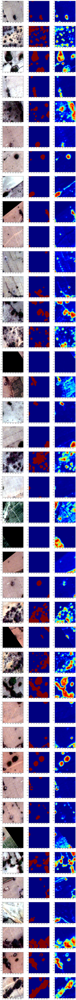

step...
shapes: (40, 160, 160, 3) (40, 160, 160, 1)


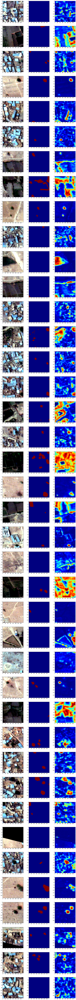

step...
shapes: (40, 160, 160, 3) (40, 160, 160, 1)


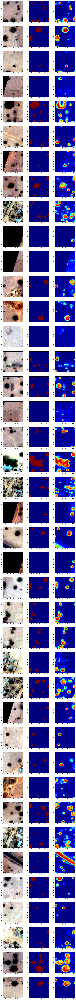

In [10]:
for patches_in, patches_out in gen(epochs=3, samples=40):
    print "step..."
    print "shapes:", patches_in.shape, patches_out.shape
    #cols = patches_in.shape[3] + patches_out.shape[3] + prediction.shape[3]
    prediction = model.model.predict(patches_in, batch_size=4)

    cols = 1 + patches_out.shape[3] + prediction.shape[3]
    rows = patches_in.shape[0]

    fig, axArr = plt.subplots(figsize=(5*cols, 5*rows), nrows=rows, ncols=cols)  
    for i in range(rows):
        #for j in range(patches_in.shape[3]):
        #    axArr[i][j].imshow(patches_in[i,:,:,j])
        axArr[i][0].imshow(patches_in[i,:,:,:])
        
        for j in range(patches_out.shape[3]):
            #k = j + patches_in.shape[3]
            k = j + 1
            axArr[i][k].imshow(patches_out[i,:,:,j])

        for j in range(prediction.shape[3]):
            #k = j + patches_in.shape[3] + patches_out.shape[3]
            k = j + 1 + patches_out.shape[3]
            axArr[i][k].imshow(prediction[i,:,:,j])

    plt.show()